Before you turn this assignment in, make sure everything runs as expected. First, **restart the kernel** (in the menubar, select Kernel$\rightarrow$Restart) and then **run all cells** (in the menubar, select Cell$\rightarrow$Run All). Lastly, hit **Validate**.

If you worked locally, and then uploaded your work to the hub, make sure to follow these steps:
- open your uploaded notebook **on the hub**
- hit the validate button right above this cell, from inside the notebook

These  steps should solve any issue related to submitting the notebook on the hub.

Make sure you fill in any place that says `YOUR CODE HERE` or "YOUR ANSWER HERE", as well as your name and collaborators below:

In [1]:
NAME = "Dhanush Patel"
COLLABORATORS = ""

---

# Lab 4: Plotting, smoothing, transformation

## Course Policies

Here are some important course policies. These are also located at
http://www.ds100.org/sp18/.

**Collaboration Policy**

Data science is a collaborative activity. While you may talk with others about
the homework, we ask that you **write your solutions individually**. If you do
discuss the assignments with others please **include their names** at the top
of your solution.


## Due Date

This assignment is due at 11:59pm Monday, February 12th. Instructions for submission are on the website.

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import zipfile

plt.style.use('fivethirtyeight') # Use plt.style.available to see more styles
sns.set()
sns.set_context("talk")
%matplotlib inline

## Objectives for Lab 4:

In this lab you will get some practice plotting, applying data transformations, and working with kernel density estimators.  We will be working with data from the world bank containing various statistics for countries and territories around the world.  

## Question 0

We will again need the `fetch_and_cache` utility.
Import it from `utils.py` (attached with this assignment) or redefine it below.

In [3]:
from utils import *

In [4]:
# This checks whether you imported/defined fetch_and_cache
import types
assert type(fetch_and_cache) == types.FunctionType

In [5]:
data_url = 'http://www.ds100.org/sp18/assets/datasets/lab04_data.zip'
file_name = 'lab04_data.zip'

dest_path = fetch_and_cache(data_url=data_url, file=file_name)
print(f'Located at {dest_path}')

Using version already downloaded: Mon Feb 12 23:09:34 2018
MD5 hash of file: 9a337ebcb37beec258bb1b39022ddfdb
Located at data/lab04_data.zip


Here, the ZIP archive contains a data folder with a few files in it. This is similar to what you had in lab 3.

To get the CSV files we want to work with, directly extract the data folder in the zip archive in the **current working directory**, which is denoted with the `.` in the cell below.

In [6]:
my_zip = zipfile.ZipFile(dest_path, 'r')
# Note the '.' argument
my_zip.extractall('.')

Now, let us load some world bank data into a pandas.DataFrame object named ```wb```.

In [7]:
wb = pd.read_csv("data/world_bank_misc.csv", index_col=0)
wb.head()

,Primary completion rate: Male: % of relevant age group: 2015,Primary completion rate: Female: % of relevant age group: 2015,Lower secondary completion rate: Male: % of relevant age group: 2015,Lower secondary completion rate: Female: % of relevant age group: 2015,Youth literacy rate: Male: % of ages 15-24: 2005-14,Youth literacy rate: Female: % of ages 15-24: 2005-14,Adult literacy rate: Male: % ages 15 and older: 2005-14,Adult literacy rate: Female: % ages 15 and older: 2005-14,Students at lowest proficiency on PISA: Mathematics: % of 15 year-olds: 2015,Students at lowest proficiency on PISA: Reading: % of 15 year-olds: 2015,...,Access to improved sanitation facilities: % of population: 1990,Access to improved sanitation facilities: % of population: 2015,Child immunization rate: Measles: % of children ages 12-23 months: 2015,Child immunization rate: DTP3: % of children ages 12-23 months: 2015,Children with acute respiratory infection taken to health provider: % of children under age 5 with ARI: 2009-2016,Children with diarrhea who received oral rehydration and continuous feeding: % of children under age 5 with diarrhea: 2009-2016,Children sleeping under treated bed nets: % of children under age 5: 2009-2016,Children with fever receiving antimalarial drugs: % of children under age 5 with fever: 2009-2016,Tuberculosis: Treatment success rate: % of new cases: 2014,Tuberculosis: Cases detection rate: % of new estimated cases: 2015
Afghanistan,NaN,NaN,NaN,NaN,62.0,32.0,45.0,18.0,NaN,NaN,...,21.0,32.0,68.0,78.0,62.0,41.0,4.6,11.8,87.0,58.0
Albania,108.0,105.0,97.0,97.0,99.0,99.0,98.0,96.0,26.0,7.0,...,78.0,93.0,98.0,98.0,70.0,63.0,NaN,NaN,88.0,76.0
Algeria,106.0,105.0,68.0,85.0,96.0,92.0,83.0,68.0,51.0,11.0,...,80.0,88.0,95.0,95.0,66.0,42.0,NaN,NaN,88.0,80.0
American Samoa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,61.0,63.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,87.0
Andorra,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,100.0,100.0,96.0,97.0,NaN,NaN,NaN,NaN,83.0,87.0


This table contains some interesting columns.  Take a look:

In [8]:
list(wb.columns)

['Primary completion rate: Male: % of relevant age group: 2015',
 'Primary completion rate: Female: % of relevant age group: 2015',
 'Lower secondary completion rate: Male: % of relevant age group: 2015',
 'Lower secondary completion rate: Female: % of relevant age group: 2015',
 'Youth literacy rate: Male: % of ages 15-24: 2005-14',
 'Youth literacy rate: Female: % of ages 15-24: 2005-14',
 'Adult literacy rate: Male: % ages 15 and older: 2005-14',
 'Adult literacy rate: Female: % ages 15 and older: 2005-14',
 'Students at lowest proficiency on PISA: Mathematics: % of 15 year-olds: 2015',
 'Students at lowest proficiency on PISA: Reading: % of 15 year-olds: 2015',
 'Students at lowest proficiency on PISA: Science: % of 15 year-olds: 2015',
 'Population: millions: 2016',
 'Surface area: sq. km thousands: 2016',
 'Population density: people per sq. km: 2016',
 'Gross national income, Atlas method: $ billions: 2016',
 'Gross national income per capita, Atlas method: $: 2016',
 'Purchasin

# Part 1: Scaling

In the first part of this assignment we will be scaling the data to linearize visualizations.


## Question 1:

Extract the fields corresponding to the **adult literacy rate in Female ages 15 and older for 2005-14** and the **gross national income per capita (atlas method)** into a new dataframe.  Then drop any rows that are missing values.

In [9]:
df = pd.DataFrame(index=wb.index)
df['lit'] = wb['Adult literacy rate: Female: % ages 15 and older: 2005-14']
df['inc'] = wb['Gross national income per capita, Atlas method: $: 2016']

df.dropna(inplace=True)
print("Original records:", len(wb))
print("Final records:", len(df))

Original records: 216
Final records: 147


In [10]:
assert np.isclose(df['lit'].mean(),78.435, rtol=0.01)
assert np.isclose(df['inc'].mean(),7919.251, rtol=0.01)

## Question 2a:

Use the seaborn `distplot` tool to construct histograms for the adult literacy data and the income data:

Text(0.5,0,'Gross national income per capita, Atlas method: $: 2016')

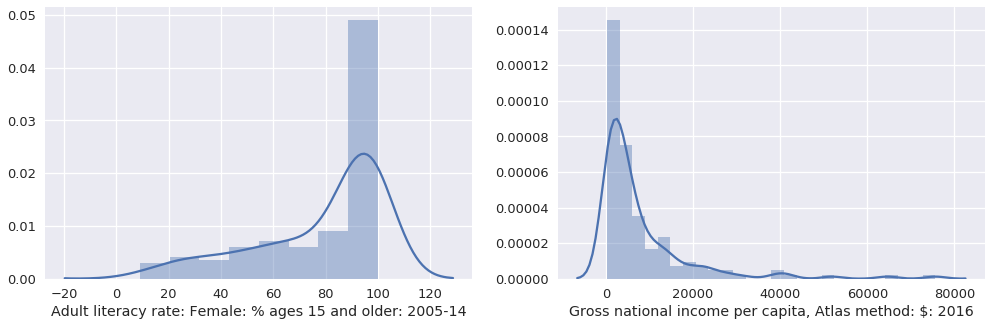

In [11]:
plt.figure(figsize=(15,5))

plt.subplot(1,2,1)
# Make plot here

# YOUR CODE HERE
sns.distplot(df["lit"])

plt.xlabel("Adult literacy rate: Female: % ages 15 and older: 2005-14")



plt.subplot(1,2,2)
# Make plot here

# YOUR CODE HERE
sns.distplot(df["inc"])

plt.xlabel('Gross national income per capita, Atlas method: $: 2016')


## Question 2b

One of the above plots could benefit from a log transformation.  Which one?

In [12]:
needs_log_transformation = "inc"

In [13]:
# Do not modify this cell

## Question 2c

Remake the appropriate plot with the data transformed using `log10`. Be sure to correct the axis label:

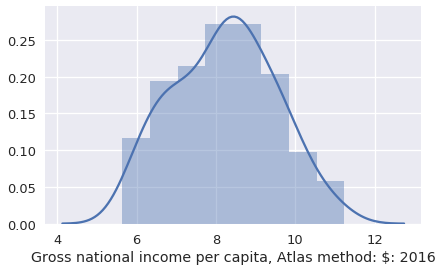

In [14]:
plt.figure()

dataz = df["inc"].apply(lambda x: np.log(x))
graphz = sns.distplot(dataz)
plt.xlabel('Gross national income per capita, Atlas method: $: 2016');


# Part 2: Kernel Density Estimation

In this part of the lab you will implement a kernel density estimator.


Let's implement our own version of the KDE plot above.  Below we give you the Guassian Kernel function

$$\Large
K_\alpha(x, z) = \frac{1}{\sqrt{2 \pi \alpha^2}} \exp\left(-\frac{(x - z)^2}{2  \alpha ^2} \right)
$$

In [15]:
def gaussian_kernel(alpha, x, z):
    return 1.0/np.sqrt(2. * np.pi * alpha**2) * np.exp(-(x - z) ** 2 / (2.0 * alpha**2))

## Question 3a
Implement the KDE function which computes:

$$\Large
f_\alpha(x) = \frac{1}{n} \sum_{i=1}^n K_\alpha(x, z_i)
$$

Where $z_i$ are the data and $\alpha$ is a parameter to control the smoothness

In [16]:
def kde(kernel, alpha, x, data):
    """
    Compute the kernel density estimate for the single query point x.

    Args:
        kernel: a kernel function with 3 parameters: alpha, x, data
        alpha: the smoothing parameter to pass to the kernel
        x: a single query point (in one dimension)
        data: a numpy array of data points

    Returns:
        The smoothed estimate at the query point x
    """
    ...
    print(kernel, alpha, x, data)
    total = 0
    for i in range(len(data)):
        val = kernel(alpha,x,data[i])
        total += val
    total /= len(data)
    print(total)
    return total

In [17]:
assert np.isclose(kde(gaussian_kernel, 1.0, 2.0, np.array([3.0, 4.0, 5.0, 7.0])), 0.075099)

<function gaussian_kernel at 0x7f44cca6c488> 1.0 2.0 [ 3.  4.  5.  7.]
0.0750987565409


## Question 3b
Create two new columns `trans_lit` and `trans_inc` that transform the `lit` and `inc` columns using `log10`. This should be similar to what you did in Question 2c.


In [18]:
df['trans_lit'] = df["lit"].apply(lambda x: np.log(x))
df['trans_inc'] = df["inc"].apply(lambda x: np.log(x))

In [19]:
assert np.isclose(np.corrcoef(df['trans_lit'], df['trans_inc'])[0,1], 0.67196)

Now let's test your function to generate a plot. You may find the ```np.linspace``` function helpful when plotting the KDE curve.

<function gaussian_kernel at 0x7f44cca6c488> 1.0 5.63478960317 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

0.0842709402912
<function gaussian_kernel at 0x7f44cca6c488> 1.0 5.7188619049 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central Af

0.0899218014306
<function gaussian_kernel at 0x7f44cca6c488> 1.0 5.79172456639 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central A

0.0921205994297
<function gaussian_kernel at 0x7f44cca6c488> 1.0 5.81974866697 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central A

<function gaussian_kernel at 0x7f44cca6c488> 1.0 5.94865952962 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 6.09438485261 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 6.24571499572 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 6.38023067848 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 6.58200420263 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 6.67728614458 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 6.83422110781 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 6.96313197046 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 7.11446211356 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 7.23216333598 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 7.40030793944 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 7.52921880208 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 7.69175858542 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 7.78143570727 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 7.93276585037 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 8.04486225268 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 8.21300685613 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 8.29147433774 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 8.49324786189 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 8.52127196246 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 8.79030332799 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 8.89119009006 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 9.03131059294 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 9.1658262757 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic  

<function gaussian_kernel at 0x7f44cca6c488> 1.0 9.31715641881 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 9.40122872054 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 9.56937332399 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 9.59739742457 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 9.86642879009 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 9.9785251924 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic  

<function gaussian_kernel at 0x7f44cca6c488> 1.0 10.1298553355 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 10.3092095792 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 10.4325156217 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 10.5894505849 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 10.6959421671 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 10.8752964108 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 10.981787993 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic  

<function gaussian_kernel at 0x7f44cca6c488> 1.0 11.1555374166 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 11.2059807976 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

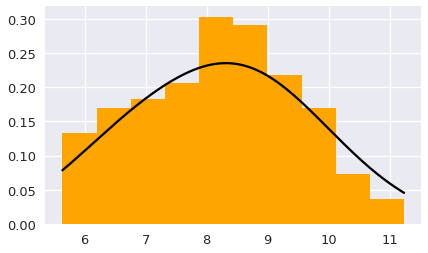

In [20]:
alpha = 1.0
xs = np.linspace(df['trans_inc'].min(), df['trans_inc'].max(), 1000)
curve = [kde(gaussian_kernel, alpha, x, df['trans_inc']) for x in xs]
plt.hist(df['trans_inc'], normed=True, color='orange')
plt.plot(xs, curve, 'k-')

## Question 3c

Let's see what happens as we vary alpha.  Plot alpha values in (0.2, 0.4, ..., 1.6, 1.8) on a 3x3 grid. Title each subplot with "alpha = &lt;value&gt;".

Hint: Take a look at the `plt.subplot` function to help create the grid

alphas len 9 [ 0.2  0.4  0.6  0.8  1.   1.2  1.4  1.6  1.8]
<function gaussian_kernel at 0x7f44cca6c488> 0.2 5.63478960317 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cam

<function gaussian_kernel at 0x7f44cca6c488> 0.2 5.89821614858 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.2 6.18966679457 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.2 6.52595600148 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.2 6.794987367 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic   

<function gaussian_kernel at 0x7f44cca6c488> 0.2 7.07522837276 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

0.179466099443
<function gaussian_kernel at 0x7f44cca6c488> 0.2 7.39470311932 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central Af

<function gaussian_kernel at 0x7f44cca6c488> 0.2 7.66933930496 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.2 7.96078995095 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.2 8.28026469751 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.2 8.62215872454 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.2 8.89679491018 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.2 9.1658262757 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic  

<function gaussian_kernel at 0x7f44cca6c488> 0.2 9.45727692169 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.2 9.78235648837 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

0.124779800045
<function gaussian_kernel at 0x7f44cca6c488> 0.2 10.0794119545 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central Af

Name: trans_inc, Length: 147, dtype: float64
0.0666776423156
<function gaussian_kernel at 0x7f44cca6c488> 0.2 10.4717493625 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Ca

<function gaussian_kernel at 0x7f44cca6c488> 0.2 10.7575951884 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

0.0349033580634
<function gaussian_kernel at 0x7f44cca6c488> 0.2 11.0378361942 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central A

<function gaussian_kernel at 0x7f44cca6c488> 0.4 5.78611974628 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 6.06636075203 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

Name: trans_inc, Length: 147, dtype: float64
0.159497902079
<function gaussian_kernel at 0x7f44cca6c488> 0.4 6.38023067848 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cam

<function gaussian_kernel at 0x7f44cca6c488> 0.4 6.66047168424 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 6.9799464308 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic  

<function gaussian_kernel at 0x7f44cca6c488> 0.4 7.22095369575 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 7.52921880208 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 7.7926453475 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic  

<function gaussian_kernel at 0x7f44cca6c488> 0.4 8.12332973429 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 8.40357074004 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 8.71183584638 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 8.99768167225 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 9.29473713835 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 9.58058296422 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 9.87763843032 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 10.1410649757 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 10.443725262 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic  

<function gaussian_kernel at 0x7f44cca6c488> 0.4 10.690337347 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic  

<function gaussian_kernel at 0x7f44cca6c488> 0.4 11.0042072735 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.4 11.2340048982 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 5.88140168824 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 6.15043305376 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 6.49232708078 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 6.76696326643 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 7.07522837276 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 7.34425973828 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 7.62450074404 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 7.91595139003 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 8.22982131648 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 8.56050570327 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 8.81832742856 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 9.22747929697 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 9.52453476307 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 9.84961432975 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 10.0850167746 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 10.3708626005 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.6 10.7239662677 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

0.0429429678582
<function gaussian_kernel at 0x7f44cca6c488> 0.6 11.0042072735 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central A

0 2
<function gaussian_kernel at 0x7f44cca6c488> 0.8 5.63478960317 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Repub

<function gaussian_kernel at 0x7f44cca6c488> 0.8 5.89821614858 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 6.18966679457 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 6.49232708078 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 6.794987367 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic   

0.192903691156
<function gaussian_kernel at 0x7f44cca6c488> 0.8 7.07522837276 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central Af

<function gaussian_kernel at 0x7f44cca6c488> 0.8 7.36107419863 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 7.71417786588 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 8.05046707279 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 8.35873217912 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 8.62215872454 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 8.89119009006 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 9.18824555616 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 9.46848656192 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 9.74872756768 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 10.0177589332 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 10.2867902987 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 10.5390072039 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 0.8 10.6342891459 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

0.0758840577066
<function gaussian_kernel at 0x7f44cca6c488> 0.8 10.6623132464 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central A

<function gaussian_kernel at 0x7f44cca6c488> 0.8 10.9705783528 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

1 0
<function gaussian_kernel at 0x7f44cca6c488> 1.0 5.63478960317 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Repub

<function gaussian_kernel at 0x7f44cca6c488> 1.0 5.91503060893 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 6.18966679457 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 6.4979319009 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic  

<function gaussian_kernel at 0x7f44cca6c488> 1.0 6.77256808654 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 7.05841391241 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 7.29942117736 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 7.61329110381 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 7.84869354865 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 8.14574901475 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 8.39796591993 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 8.67260210557 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 8.95844793144 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 9.27792267801 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 9.52453476307 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 9.85521914986 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 10.0177589332 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 10.0457830338 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 10.1859035367 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 10.5390072039 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.0 10.8809012309 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

1 1
<function gaussian_kernel at 0x7f44cca6c488> 1.2 5.63478960317 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Repub

<function gaussian_kernel at 0x7f44cca6c488> 1.2 5.92624024916 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 6.26813427618 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 6.53156082159 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 6.82861628769 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 7.06962355264 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 7.36667901875 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

0.208255952047
<function gaussian_kernel at 0x7f44cca6c488> 1.2 7.63010556416 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central Af

<function gaussian_kernel at 0x7f44cca6c488> 1.2 7.94958031072 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 8.23542613659 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 8.51566714235 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 8.82393224868 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 9.19945519639 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 9.55255886365 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 9.84400950963 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 10.1634842562 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 10.4549349022 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 10.8304578499 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.2 11.1611422367 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 5.90942578881 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 6.13922341353 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 6.44748851986 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 6.73333434574 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

Name: trans_inc, Length: 147, dtype: float64
0.171747949342
<function gaussian_kernel at 0x7f44cca6c488> 1.4 7.03599463195 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cam

<function gaussian_kernel at 0x7f44cca6c488> 1.4 7.32744527794 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 7.61329110381 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 7.94958031072 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 8.25224059694 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 8.56611052338 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 8.85195634926 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 9.15461663547 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 9.44046246134 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 9.79917094871 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 10.1018312349 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 10.3876770608 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.4 10.7071518074 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

Name: trans_inc, Length: 147, dtype: float64
0.0751467866625
<function gaussian_kernel at 0x7f44cca6c488> 1.4 10.9761831729 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Ca

<function gaussian_kernel at 0x7f44cca6c488> 1.6 5.67962816409 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 5.97107881008 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 6.32978729745 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 6.59321384286 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 6.95752715034 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 7.26579225667 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 7.57966218312 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 7.86550800899 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 8.14014419463 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 8.45401412108 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 8.71183584638 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 8.99768167225 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 9.31715641881 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 9.6086070648 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic  

<function gaussian_kernel at 0x7f44cca6c488> 1.6 9.90005771079 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 10.1802987165 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.6 10.4717493625 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

0.0879011197244
<function gaussian_kernel at 0x7f44cca6c488> 1.6 10.8304578499 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central A

<function gaussian_kernel at 0x7f44cca6c488> 1.6 11.1106988557 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.8 5.81414384685 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.8 6.16164269399 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.8 6.53156082159 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.8 6.83982592792 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.8 7.1649054946 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic  

<function gaussian_kernel at 0x7f44cca6c488> 1.8 7.45075132047 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.8 7.81506462796 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

0.178351876415
<function gaussian_kernel at 0x7f44cca6c488> 1.8 8.1289345544 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central Afr

<function gaussian_kernel at 0x7f44cca6c488> 1.8 8.39796591993 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

Name: trans_inc, Length: 147, dtype: float64
0.174735724385
<function gaussian_kernel at 0x7f44cca6c488> 1.8 8.68941656592 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cam

<function gaussian_kernel at 0x7f44cca6c488> 1.8 9.05933469352 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.8 9.33957569927 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.8 9.70388900676 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.8 10.0513878539 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.8 10.3652577803 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.8 10.6791277068 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

<function gaussian_kernel at 0x7f44cca6c488> 1.8 10.9986024534 Afghanistan                  6.363028
Albania                      8.354674
Algeria                      8.359369
Angola                       8.143227
Antigua and Barbuda          9.503010
Argentina                    9.389323
Armenia                      8.232174
Azerbaijan                   8.468003
Bahrain                     10.032320
Bangladesh                   7.192934
Belarus                      8.630522
Benin                        6.709304
Bhutan                       7.828038
Bolivia                      8.029433
Bosnia and Herzegovina       8.492900
Botswana                     8.796339
Brazil                       9.087042
Brunei Darussalam           10.558933
Bulgaria                     8.918650
Burkina Faso                 6.461468
Burundi                      5.634790
Cabo Verde                   7.996317
Cambodia                     7.038784
Cameroon                     7.090077
Central African Republic 

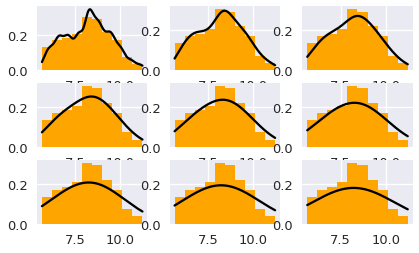

In [21]:
fig = plt.figure(figsize=(15,15))
alphas = np.arange(0.2,2.0,0.2)
print("alphas len",len(alphas),alphas)
fig, grid = plt.subplots(3,3)
x = 0
y = 0
for i, alpha in enumerate(alphas):
    xs = np.linspace(df['trans_inc'].min(), df['trans_inc'].max(), 1000)
    curve = [kde(gaussian_kernel, alpha, x, df['trans_inc']) for x in xs]
    grid[x,y].hist(df['trans_inc'], normed=True, color='orange')
    grid[x,y].plot(xs, curve, 'k-')
    print(x,y)
    if y == 2:
        y = 0
        x += 1
    else:
        y += 1

How does increasing alpha affect the curves? Explain any pattern/trend you see in the cell below. 

Increasing alpha increases smoothness of the curve and also lowers the curves' height and decreases the number of peaks/valleys; this is likely due to averaging the data more.

## Question 3d

We can also try other kernel functions such as the [boxcar kernel](https://en.wikipedia.org/wiki/Boxcar_function).


In [22]:
def boxcar_kernel(alpha, x, z):
    return (((x-z)>=-alpha/2)&((x-z)<=alpha/2))/alpha

Run the cell below to enable interactive plots. It should give you a green 'OK' when it's finished.

In [23]:
from ipywidgets import interact
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK


Now, we can plot the kernel function to see what it looks like.

In [24]:
x = np.linspace(-10,10,1000)
def f(alpha):
    plt.plot(x, boxcar_kernel(alpha,x,0), label='Boxcar')
    plt.plot(x, gaussian_kernel(alpha,x,0), label='Gaussian')
    plt.legend(title='Kernel Function')
    plt.show()
interact(f, alpha=(1,10,0.1))

interactive(children=(FloatSlider(value=5.0, description='alpha', max=10.0, min=1.0), Output()), _dom_classes=('widget-interact',))

<function __main__.f>

Using the interactive plot below compare the the two kernel techniques:  (Generating the KDE plot is slow, so you may expect some latency after you move the slider)

In [25]:
xs = np.linspace(df['trans_inc'].min(), df['trans_inc'].max(), 1000)
def f(alpha_g, alpha_b):
    plt.hist(df['trans_inc'], normed=True, color='orange')
    g_curve = [kde(gaussian_kernel, alpha_g, x, df['trans_inc']) for x in xs]
    plt.plot(xs, g_curve, 'k-', label='Gaussian')
    b_curve = [kde(boxcar_kernel, alpha_b, x, df['trans_inc']) for x in xs]
    plt.plot(xs, b_curve, 'r-', label='Boxcar')
    plt.legend(title='Kernel Function')
    plt.show()
interact(f, alpha_g=(0.01,.5,0.01), alpha_b=(0.01,3,0.1))

interactive(children=(FloatSlider(value=0.25, description='alpha_g', max=0.5, min=0.01, step=0.01), FloatSlider(value=1.4100000000000001, description='alpha_b', max=3.0, min=0.01), Output()), _dom_classes=('widget-interact',))

<function __main__.f>

How is the boxcar kde plot comparing to previous plot using the gaussian kernel?

Gaussian is like a smooth average of the data vs. boxcar kde that is rougher, showing more details/changes in the data.

**Congrats! You are finished with this assignment. Don't forget to validate & submit before 11:59PM!**